Now that I have the map generation working (as seen in MapGeneration2), time to get the first version of the migration system working. The goal here is to instantiate a batch of people/families/agents with different colour affinities and have them move around to find the best spot for them. Nothing beyond that for this version, no evolution or breeding or anything like that.


Very basic version of the simple system working in 1.1. Time to add some functionality: bigger map, better balance, ability to have multiple set colour affinities (effectively multiple populations).

To do:
Set up a world map object with getters for colours at a given location and stuff, much nicer than the indexing I'm doing currently




Update position and creating the animation are all working but need plenty of tuning to get working well. Play around with factors to balance it all. Have a look at proposing multiple locations and metropolis checking each one or the best of them, have a look at how the affinity is judged (simplistic atm), tune the metropolis settings (steepness and range of the threshold)

In [1]:
from perlin_noise import PerlinNoise as perlin
import numpy as np
from matplotlib import pyplot as plt
import random
import matplotlib.animation

## Map generation

In [2]:
# Map settings
mapWidth = 250
mapHeight = 175

# Perlin settings
baseValue = 0.5       # Colour that the perlin noise acts as an offset from

zoomFactorr = 2       # How much the sample region is zoomed into the perlin pattern
zoomFactorg = 4       # Bigger number = more noise (I think, might be the opposite)
zoomFactorb = 3

rInfluence = 0.74     # Strength of the offsets each channel applies to the base colour
gInfluence = 0.75
bInfluence = 0.75

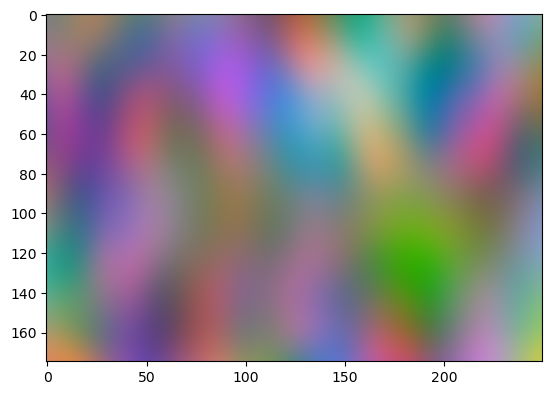

In [10]:
# Generate the perlin noise for each colour with a random seed
noiser = perlin(octaves=10, seed=random.randint(1,75))
noiseg = perlin(octaves=10, seed=random.randint(1,75))
noiseb = perlin(octaves=10, seed=random.randint(1,75))


# Range of the channel = (-1,1)*colourInfluence
rChannel = [[(noiser([i/(mapWidth*zoomFactorr), j/(mapHeight*zoomFactorr)]))*rInfluence for j in range(mapWidth)] for i in range(mapHeight)]
gChannel = [[(noiseg([i/(mapWidth*zoomFactorg), j/(mapHeight*zoomFactorg)]))*gInfluence for j in range(mapWidth)] for i in range(mapHeight)]
bChannel = [[(noiseb([i/(mapWidth*zoomFactorb), j/(mapHeight*zoomFactorb)]))*bInfluence for j in range(mapWidth)] for i in range(mapHeight)]


# 2d array of rgb colour values, instatiated with all values as rgb = (baseColour, baseColour, baseColour)
worldMap = [[np.array([baseValue,baseValue,baseValue]) for j in range(mapWidth)] for i in range(mapHeight)]

# For each location, offset the baseColour rgb value by the perlin noise for that colour
for i in range(mapWidth):
    for j in range(mapHeight):
        worldMap[j][i] = np.array([baseValue + rChannel[j][i], baseValue + gChannel[j][i], baseValue + bChannel[j][i]])



plt.imshow(worldMap, cmap='gray')
plt.show()

In [4]:
def sigmoidFunction(x, steepness):
    return 1/(1+np.exp(-steepness*x))

In [11]:
class Person:
    metropolisSteepness = 50
    searchRange = 3
    
    def __init__(self, mapWidth, mapHeight, baseColour):
        self.x = random.randint(1,mapWidth-1)
        self.y = random.randint(1,mapHeight-1)
        
        self.colourAffinity = np.array([random.random(), random.random(), random.random()])
        # Very good chance I might want to change this to an offset from a baseColour
        
    def move(self):
        # Loads of options for picking a new location, go with this for now
        # pseudocode: find magnitude of difference between current location and colour affinity
        # propose a new point within a certain range (hardcoded for now)
        # Metropolis check that new one vs the current one
        # set location to new one if passed, keep current location if failed
        
        proposedx = self.x + random.randint(-self.searchRange,self.searchRange)
        proposedy = self.y + random.randint(-self.searchRange,self.searchRange)
        
        # Make sure the proposed location is still in the map range
        proposedx = min(max(1,proposedx),mapWidth-1)
        proposedy = min(max(1,proposedy),mapHeight-1)
        #print([self.x, self.y])
        #print([proposedx, proposedy])
        
        currentDifference = worldMap[self.y][self.x] - self.colourAffinity
        proposedDifference = worldMap[proposedy][proposedx] - self.colourAffinity
        
        currentDifferenceMagnitude = np.sum(currentDifference**2)
        proposedDifferenceMagnitude = np.sum(proposedDifference**2)

        # Metropolis check with hardcoded thresholds and stuff
        threshold = random.random()
        
        if sigmoidFunction(currentDifferenceMagnitude - proposedDifferenceMagnitude, self.metropolisSteepness) > threshold:
            self.x = proposedx
            self.y = proposedy        
        
            
        #return proposedDifferenceMagnitude - currentDifferenceMagnitude

        
        
class PersonList:
    
    def __init__(self, numPeople, mapWidth, mapHeight, baseColour):
        self.numPeople = numPeople
        self.people = [Person(mapWidth, mapHeight, baseColour) for i in range(numPeople)]
        #self.affinityDiffs = np.zeros(numPeople)
        
        
        
    # Convenience functions to return the properties of all people in the list
    def xLocations(self):
        xLocs = [0 for i in range(self.numPeople)]
        for i in range(self.numPeople):
            xLocs[i] = self.people[i].x
        return xLocs
    
    def yLocations(self):
        yLocs = [0 for i in range(self.numPeople)]
        for i in range(self.numPeople):
            yLocs[i] = self.people[i].y
        return yLocs
    
    def colourAffinities(self):
        affinities = [[0,0,0] for i in range(self.numPeople)]
        for i in range(self.numPeople):
            affinities[i] = self.people[i].colourAffinity
        return affinities
    
    def draw(self):
        plt.scatter(self.xLocations(), self.yLocations(), c=(self.colourAffinities()))
        
    def update(self):
        for i in range(self.numPeople):
            self.people[i].move()
            #self.affinityDiffs[i] = self.people[i].move()
        #print(self.affinityDiffs)



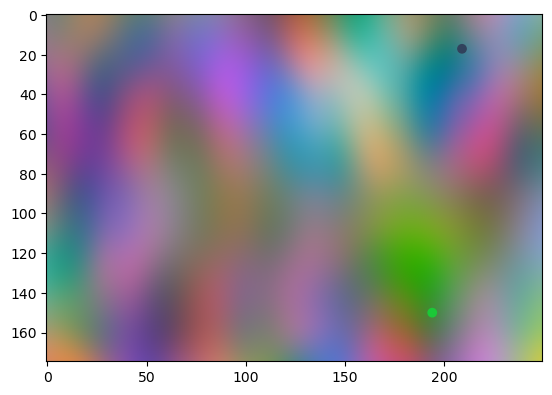

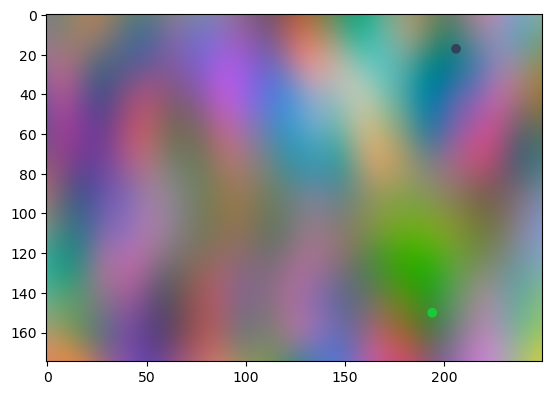

In [12]:
# Test the classes and drawing the people
testList = PersonList(2, mapWidth, mapHeight, baseValue)

plt.imshow(worldMap, cmap='gray')
testList.draw()
plt.show()

plt.imshow(worldMap, cmap='gray')
testList.update()
testList.draw()
plt.show()

In [14]:
# Animation testing

testList = PersonList(10, mapWidth, mapHeight, baseValue)

plt.rcParams["animation.html"] = "jshtml"
#plt.rcParams['figure.dpi'] = 150  
plt.ioff()
fig, ax = plt.subplots()

def animate(t):
    plt.cla()
    plt.imshow(worldMap, cmap='gray')
    testList.update()
    testList.draw()
    #plt.show()

matplotlib.animation.FuncAnimation(fig, animate, frames=200, interval=60)

Animation size has reached 21137815 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [164]:
# Animation testing

plt.rcParams["animation.html"] = "jshtml"
plt.rcParams['figure.dpi'] = 150  
plt.ioff()
fig, ax = plt.subplots()

x = np.linspace(0,10,100)
def animate(t):
    plt.cla()
    plt.plot(x,np.sin(x+t))
    plt.xlim(0,10)

matplotlib.animation.FuncAnimation(fig, animate, frames=20)

In [178]:
# Test out the sigmoid function
plt.figure(dpi=200)

squishFactor = 50
plotRange = 0.3

x = np.arange(-plotRange,plotRange,0.01)

plt.plot(x, 1/(1+np.exp(-squishFactor*x)))
plt.scatter(testList.affinityDiffs, 1/(1+np.exp(-squishFactor*testList.affinityDiffs)))

plt.grid()

AttributeError: 'PersonList' object has no attribute 'affinityDiffs'

In [123]:
worldMap[99][139]

array([0.32307083, 0.78490276, 0.52384041])